In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import plotly.express as px
import statistics as stat
import scipy.cluster.hierarchy as hier
from mpl_toolkits.mplot3d import Axes3D
from sklearn.cluster import AffinityPropagation, KMeans, DBSCAN, OPTICS
import gower
from sklearn.metrics import davies_bouldin_score, silhouette_score

# Data pre-processing

In [3]:
# dane dotyczące sprzedaży gier komputerowych (również w wersjach na inne platformy)
df = pd.read_csv("VideoGamesSales.csv")
df.sort_values(['Year'], ascending = False)

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
5957,5959,Imagine: Makeup Artist,DS,2020.0,Simulation,Ubisoft,0.27,0.00,0.00,0.02,0.29
14390,14393,Phantasy Star Online 2 Episode 4: Deluxe Package,PS4,2017.0,Role-Playing,Sega,0.00,0.00,0.03,0.00,0.03
16241,16244,Phantasy Star Online 2 Episode 4: Deluxe Package,PSV,2017.0,Role-Playing,Sega,0.00,0.00,0.01,0.00,0.01
16438,16441,Brothers Conflict: Precious Baby,PSV,2017.0,Action,Idea Factory,0.00,0.00,0.01,0.00,0.01
8293,8295,Shin Megami Tensei IV: Final,3DS,2016.0,Role-Playing,Deep Silver,0.03,0.00,0.14,0.00,0.17
...,...,...,...,...,...,...,...,...,...,...,...
16307,16310,Freaky Flyers,GC,NaN,Racing,Unknown,0.01,0.00,0.00,0.00,0.01
16327,16330,Inversion,PC,NaN,Shooter,Namco Bandai Games,0.01,0.00,0.00,0.00,0.01
16366,16369,Hakuouki: Shinsengumi Kitan,PS3,NaN,Adventure,Unknown,0.01,0.00,0.00,0.00,0.01
16427,16430,Virtua Quest,GC,NaN,Role-Playing,Unknown,0.01,0.00,0.00,0.00,0.01


In [4]:
# Pozbycie się pierwszych 4 pozycji (outlier-y)
df = df.sort_values(['Year'], ascending = False)[4:]
df.describe(include='all')

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
count,16594.000000,16594,16594,16323.000000,16594,16536,16594.000000,16594.000000,16594.000000,16594.000000,16594.000000
unique,NaN,11490,31,NaN,12,578,NaN,NaN,NaN,NaN,NaN
top,NaN,Need for Speed: Most Wanted,DS,NaN,Action,Electronic Arts,NaN,NaN,NaN,NaN,NaN
freq,NaN,12,2162,NaN,3315,1351,NaN,NaN,NaN,NaN,NaN
mean,8299.409967,NaN,NaN,2006.403664,NaN,NaN,0.264715,0.146687,0.077797,0.048073,0.537550
std,4791.349951,NaN,NaN,5.826954,NaN,NaN,0.816774,0.505407,0.309326,0.188610,1.555198
min,1.000000,NaN,NaN,1980.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.010000
25%,4150.250000,NaN,NaN,2003.000000,NaN,NaN,0.000000,0.000000,0.000000,0.000000,0.060000
50%,8299.500000,NaN,NaN,2007.000000,NaN,NaN,0.080000,0.020000,0.000000,0.010000,0.170000
75%,12447.750000,NaN,NaN,2010.000000,NaN,NaN,0.240000,0.110000,0.040000,0.040000,0.470000


In [5]:
df.isna().sum()

Rank              0
Name              0
Platform          0
Year            271
Genre             0
Publisher        58
NA_Sales          0
EU_Sales          0
JP_Sales          0
Other_Sales       0
Global_Sales      0
dtype: int64

In [6]:
df['Publisher'] = df['Publisher'].fillna('No data')
df.isna().sum()

Rank              0
Name              0
Platform          0
Year            271
Genre             0
Publisher         0
NA_Sales          0
EU_Sales          0
JP_Sales          0
Other_Sales       0
Global_Sales      0
dtype: int64

In [7]:
# uzupelnienie rokiem z nazwy (wyrażenia regularne)
df['Year_str'] = df['Name'].str.extract('.*([1-3][0-9]{3})').astype(float)-1
df[pd.isna(df['Year'])]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Year_str
179,180,Madden NFL 2004,PS2,NaN,Sports,Electronic Arts,4.26,0.26,0.01,0.71,5.23,2003.0
377,378,FIFA Soccer 2004,PS2,NaN,Sports,Electronic Arts,0.59,2.36,0.04,0.51,3.49,2003.0
431,432,LEGO Batman: The Videogame,Wii,NaN,Action,Warner Bros. Interactive Entertainment,1.86,1.02,0.00,0.29,3.17,NaN
470,471,wwe Smackdown vs. Raw 2006,PS2,NaN,Fighting,No data,1.57,1.02,0.00,0.41,3.00,2005.0
607,608,Space Invaders,2600,NaN,Shooter,Atari,2.36,0.14,0.00,0.03,2.53,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
16307,16310,Freaky Flyers,GC,NaN,Racing,Unknown,0.01,0.00,0.00,0.00,0.01,NaN
16327,16330,Inversion,PC,NaN,Shooter,Namco Bandai Games,0.01,0.00,0.00,0.00,0.01,NaN
16366,16369,Hakuouki: Shinsengumi Kitan,PS3,NaN,Adventure,Unknown,0.01,0.00,0.00,0.00,0.01,NaN
16427,16430,Virtua Quest,GC,NaN,Role-Playing,Unknown,0.01,0.00,0.00,0.00,0.01,NaN


In [8]:
# uzupelnienie rokiem z nazwy (wyrażenia regularne)
df['Year_new'] = np.where(pd.isna(df['Year']), df['Year_str'], df['Year'])
df['Year'] = df['Year_new']
df = df.drop(['Year_str','Year_new'], axis=1)
df[pd.isna(df['Year'])]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales
431,432,LEGO Batman: The Videogame,Wii,NaN,Action,Warner Bros. Interactive Entertainment,1.86,1.02,0.0,0.29,3.17
607,608,Space Invaders,2600,NaN,Shooter,Atari,2.36,0.14,0.0,0.03,2.53
624,625,Rock Band,X360,NaN,Misc,Electronic Arts,1.93,0.34,0.0,0.21,2.48
649,650,Frogger's Adventures: Temple of the Frog,GBA,NaN,Adventure,Konami Digital Entertainment,2.15,0.18,0.0,0.07,2.39
652,653,LEGO Indiana Jones: The Original Adventures,Wii,NaN,Action,LucasArts,1.54,0.63,0.0,0.22,2.39
...,...,...,...,...,...,...,...,...,...,...,...
16307,16310,Freaky Flyers,GC,NaN,Racing,Unknown,0.01,0.00,0.0,0.00,0.01
16327,16330,Inversion,PC,NaN,Shooter,Namco Bandai Games,0.01,0.00,0.0,0.00,0.01
16366,16369,Hakuouki: Shinsengumi Kitan,PS3,NaN,Adventure,Unknown,0.01,0.00,0.0,0.00,0.01
16427,16430,Virtua Quest,GC,NaN,Role-Playing,Unknown,0.01,0.00,0.0,0.00,0.01


In [9]:
df.isna().sum()

Rank              0
Name              0
Platform          0
Year            254
Genre             0
Publisher         0
NA_Sales          0
EU_Sales          0
JP_Sales          0
Other_Sales       0
Global_Sales      0
dtype: int64

In [10]:
df['Platform'].unique()

array(['3DS', 'PS4', 'PSV', 'PS3', 'XOne', 'PC', 'WiiU', 'X360', 'PSP',
       'Wii', 'DS', 'PS2', 'DC', 'XB', 'GBA', 'GC', 'PS', 'N64', 'GB',
       'WS', 'SNES', 'SAT', 'NG', 'PCFX', '3DO', 'TG16', 'GEN', 'SCD',
       'NES', 'GG', '2600'], dtype=object)

In [11]:
# dodanie kolumny z dodaniem daty premiery platformy (za rok wydania przyjmuje sie rok wydania w kraju producenta)
platform_year = {
    "Wii": 2006.0,
    "NES": 1983.0,
    "GB": 1989.0,
    "DS": 2004.0,
    "X360": 2005.0,
    "PS3": 2006.0,
    "PS2": 2000.0,
    "SNES": 1990.0,
    "GBA": 2001.0,
    "3DS": 2011.0,
    "PS4": 2013.0,
    "N64": 1996.0,
    "PS": 1994.0,
    "XB": 2001.0,
    "PC": 1985.0,
    "2600": 1977.0,
    "PSP": 2004.0,
    "XOne": 2013.0,
    "GC": 2001.0,
    "WiiU": 2012.0,
    "GEN": 1988.0, # Sega Genesis
    "DC": 1998.0, #Dreamcast
    "PSV": 2011.0,
    "SAT": 1994.0, # Sega Saturn
    "SCD": 1991.0, # Sega CD
    "WS": 1999.0, # WonderSwan
    "NG": 1990.0, # Neo Geo
    "TG16": 1987.0, # TurboGrafx-16
    "3DO": 1993.0, # 3DO Interactive Multiplayer (Panasonic, Sanyo, GoldStar)
    "GG": 1990.0, # Sega Game Gear
    "PCFX": 1994.0
}
platform_year

{'Wii': 2006.0,
 'NES': 1983.0,
 'GB': 1989.0,
 'DS': 2004.0,
 'X360': 2005.0,
 'PS3': 2006.0,
 'PS2': 2000.0,
 'SNES': 1990.0,
 'GBA': 2001.0,
 '3DS': 2011.0,
 'PS4': 2013.0,
 'N64': 1996.0,
 'PS': 1994.0,
 'XB': 2001.0,
 'PC': 1985.0,
 '2600': 1977.0,
 'PSP': 2004.0,
 'XOne': 2013.0,
 'GC': 2001.0,
 'WiiU': 2012.0,
 'GEN': 1988.0,
 'DC': 1998.0,
 'PSV': 2011.0,
 'SAT': 1994.0,
 'SCD': 1991.0,
 'WS': 1999.0,
 'NG': 1990.0,
 'TG16': 1987.0,
 '3DO': 1993.0,
 'GG': 1990.0,
 'PCFX': 1994.0}

In [12]:
def plat_year(platf: str):
    return platform_year[platf]
df['Platform_Year'] = df['Platform'].map(lambda x: plat_year(x))
df.head(20)

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Platform_Year
8293,8295,Shin Megami Tensei IV: Final,3DS,2016.0,Role-Playing,Deep Silver,0.03,0.00,0.14,0.00,0.17,2011.0
13647,13649,Hitman (2016),PS4,2016.0,Action,Square Enix,0.00,0.04,0.00,0.01,0.04,2013.0
13596,13598,Card Fight!! Vanguard G: Stride to Victory!!,3DS,2016.0,Misc,FuRyu,0.00,0.00,0.04,0.00,0.04,2011.0
13602,13604,Refrain no Chika Meikyuu to Majo no Ryodan,PSV,2016.0,Action,Nippon Ichi Software,0.00,0.00,0.04,0.00,0.04,2011.0
13614,13616,Utawarerumono: Futari no Hakuoro,PS4,2016.0,Misc,Aqua Plus,0.00,0.00,0.04,0.00,0.04,2013.0
13620,13622,Kamen Rider: Battride War Genesis,PS3,2016.0,Action,Namco Bandai Games,0.00,0.00,0.04,0.00,0.04,2006.0
4658,4660,Hyrule Warriors,3DS,2016.0,Action,Nintendo,0.16,0.12,0.11,0.03,0.42,2011.0
13650,13652,7 Days to Die,XOne,2016.0,Action,Telltale Games,0.02,0.02,0.00,0.00,0.04,2013.0
13562,13564,Life is Strange,PC,2016.0,Adventure,Square Enix,0.01,0.03,0.00,0.00,0.04,1985.0
13702,13704,XCOM 2,PS4,2016.0,Strategy,Take-Two Interactive,0.01,0.02,0.00,0.01,0.04,2013.0


In [13]:
# sprawdzenie wszystkich tytułów, czy nie występują pozycje z premiera gry przed premiera platformy
df['Year>Platform_Year'] = np.where(df['Year'] < df['Platform_Year'], 1, 0)
df[df['Year>Platform_Year'] == 1]

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Platform_Year,Year>Platform_Year
2083,2085,NFL Fever 2002,XB,2000.0,Sports,Microsoft Game Studios,0.74,0.21,0.00,0.04,0.99,2001.0,1
12270,12272,ESPN Winter X-Games: Snowboarding 2002,GBA,2000.0,Sports,Konami Digital Entertainment,0.05,0.02,0.00,0.00,0.06,2001.0,1
1350,1352,Disney's DuckTales,GB,1988.0,Platform,Capcom,0.82,0.23,0.35,0.03,1.43,1989.0,1
15867,15870,Strongest Tokyo University Shogi DS,DS,1985.0,Action,Mycom,0.00,0.00,0.02,0.00,0.02,2004.0,1


In [14]:
# Korekta dat
df.loc[df['Year>Platform_Year'] == 1, 'Year'] = df.loc[df['Year>Platform_Year'] == 1, 'Platform_Year']
df['Year>Platform_Year'] = np.where(df['Year'] < df['Platform_Year'], 1, 0)
df[df['Year>Platform_Year'] == 1]
df = df.drop(['Year>Platform_Year'], axis=1)
df.head()

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Platform_Year
8293,8295,Shin Megami Tensei IV: Final,3DS,2016.0,Role-Playing,Deep Silver,0.03,0.00,0.14,0.00,0.17,2011.0
13647,13649,Hitman (2016),PS4,2016.0,Action,Square Enix,0.00,0.04,0.00,0.01,0.04,2013.0
13596,13598,Card Fight!! Vanguard G: Stride to Victory!!,3DS,2016.0,Misc,FuRyu,0.00,0.00,0.04,0.00,0.04,2011.0
13602,13604,Refrain no Chika Meikyuu to Majo no Ryodan,PSV,2016.0,Action,Nippon Ichi Software,0.00,0.00,0.04,0.00,0.04,2011.0
13614,13616,Utawarerumono: Futari no Hakuoro,PS4,2016.0,Misc,Aqua Plus,0.00,0.00,0.04,0.00,0.04,2013.0


In [15]:
# Uzupełnianie dat z wykorzystaniem tej samej generacji konkurencyjnych konsol (PS VS XBOX)
def PSvsXB(names: list, gen: int):
    all_names = set(df['Name'])
    if gen == 2:
        ps, xbox = 'PS2', 'XB'
    elif gen == 3:
        ps, xbox = 'PS3', 'X360'
    elif gen == 4:
        ps, xbox = 'PS4', 'XOne'
    else:
        return "Brak odpowiedniej generacji konsol!"
    for name in names:
        if name in all_names:
            a = df.loc[(df['Name'] == name) & (df['Platform'].isin([ps, xbox]))] # tabela z zawieraniem platform ps i xb
            if len(a) > 1: # jezeli wystepuja obie platformy
                try:
                    b = list({x for x in a.Year if pd.notna(x)})[0] # rok
                    df.loc[(df['Name'] == name) & (df['Platform'].isin([ps, xbox]))] = df.loc[(df['Name'] == name) & (df['Platform'].isin([ps, xbox]))].fillna(b)
                    #df.loc[(df['Name'] == name) & (df['Platform'].isin(['PS2', 'XB']))].Year = df.loc[(df['Name'] == name) & (df['Platform'].isin(['PS2', 'XB']))].Year.replace(np.nan, b) #= np.where(pd.isna(a.Year), b, a.Year)
                except:
                    continue

In [16]:
PSvsXB(set(df[pd.isna(df['Year'])].Name), 2)
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             241
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [17]:
PSvsXB(set(df[pd.isna(df['Year'])].Name), 3)
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             228
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [18]:
PSvsXB(set(df[pd.isna(df['Year'])].Name), 4)
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             228
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [19]:
# Zamiana na najwiekszy rok pozycji, ktore maja kilka dat (przypadki reedycji na nowe konsole)
def biggest_year(names: list):
    all_names = set(df['Name'])
    for name in names:
        if name in all_names:
            a = {x for x in set(df.loc[df['Name'] == name].Year) if pd.notna(x)}
            if len(a) == 1:
                b = {x for x in set(df.loc[df['Name'] == name].Platform_Year) if pd.notna(x)}
                if max(a) >= max(b):
                     df.loc[df['Name'] == name] =  df.loc[df['Name'] == name].fillna(max(a))

In [20]:
biggest_year(set(df[pd.isna(df['Year'])].Name))
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             149
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [21]:
# Uzupelnienie roku wydania dla nowych edycji starych gier na nowa konsole 3DS
def DS(names: list):
    all_names = set(df['Name'])
    for name in names:
        if name in all_names:
            a = {x for x in set(df.loc[df['Name'] == name].Year) if pd.notna(x)}
            try:
                if ((len(a) >= 1) & ('3DS' in set(df.loc[df['Name'] == name].Platform))) or ((len(a) == 0) & ('3DS' in set(df.loc[df['Name'] == name].Platform))):
                    b = df.loc[(df['Name'] == name) & (df['Platform'] == '3DS')].Platform_Year
                    df.loc[(df['Name'] == name) & (df['Platform'] == '3DS')] = df.loc[(df['Name'] == name) & (df['Platform'] == '3DS')].fillna(list(b)[0])                 
            except:
                continue

In [22]:
DS(set(df[pd.isna(df['Year'])].Name))
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             141
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [23]:
# Jedyna zmiana ręczna (ostatni relatywnie nowy tytul bez roku wydania)
df[df['Name'] == 'Disgaea 3: Absence of Detention'] = df[df['Name'] == 'Disgaea 3: Absence of Detention'].fillna(2011.0)
df.isna().sum()

Rank               0
Name               0
Platform           0
Year             140
Genre              0
Publisher          0
NA_Sales           0
EU_Sales           0
JP_Sales           0
Other_Sales        0
Global_Sales       0
Platform_Year      0
dtype: int64

In [24]:
df = df[pd.isna(df['Year']) != True]

In [25]:
df.isna().sum()

Rank             0
Name             0
Platform         0
Year             0
Genre            0
Publisher        0
NA_Sales         0
EU_Sales         0
JP_Sales         0
Other_Sales      0
Global_Sales     0
Platform_Year    0
dtype: int64

# Data mining

In [26]:
# funkcja zliczająca liczbę wystepowań elementu
def count_elements(seq: list) -> dict:
    hist = {}
    for i in seq:
        hist[i] = hist.get(i, 0) + 1
    return hist

In [27]:
df2000 = df[df['Year'] >= 2000.0]
df2010 = df[df['Year'] >= 2010.0]

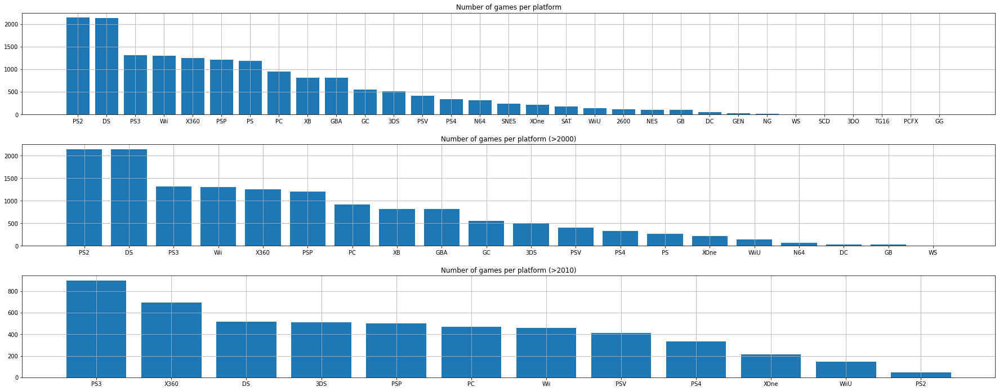

In [28]:
platform = dict(sorted(count_elements(df["Platform"]).items(), key=lambda item: item[1], reverse = True))
platform2000 = dict(sorted(count_elements(df2000["Platform"]).items(), key=lambda item: item[1], reverse = True))
platform2010 = dict(sorted(count_elements(df2010["Platform"]).items(), key=lambda item: item[1], reverse = True))

fig, axs = plt.subplots(3,1,figsize=(25,10))

axs[0].set_title("Number of games per platform")
axs[0].bar(platform.keys(), platform.values())
axs[0].grid(True)

axs[1].set_title("Number of games per platform (>2000)")
axs[1].bar(platform2000.keys(), platform2000.values())
axs[1].grid(True)

axs[2].set_title("Number of games per platform (>2010)")
axs[2].bar(platform2010.keys(), platform2010.values())
axs[2].grid(True)

fig.tight_layout(pad=2.0)

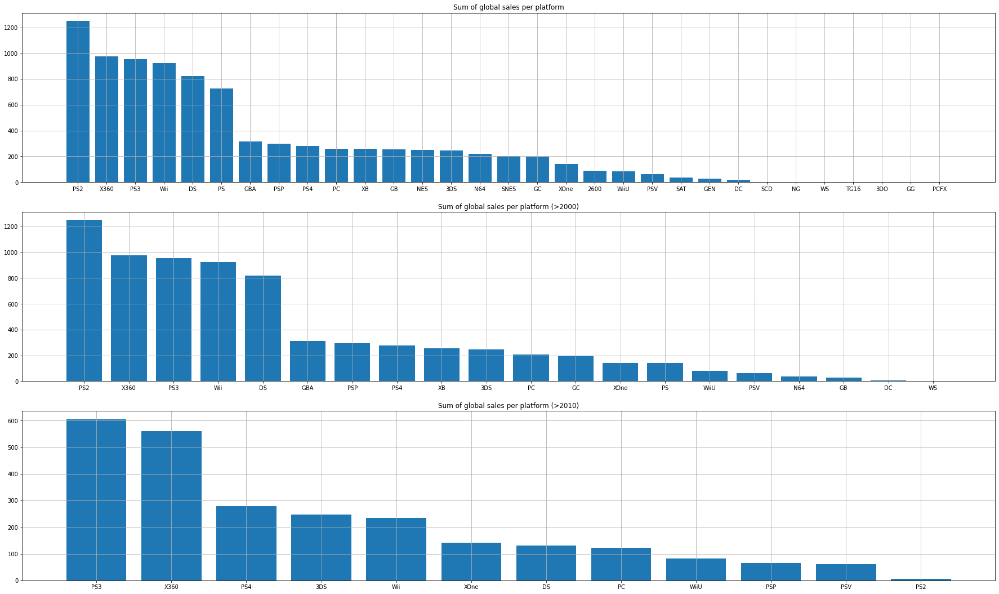

In [29]:
sales = df.groupby('Platform')['Global_Sales'].sum().sort_values(ascending = False)
names = []
values = []
for i in range(len(sales)):
    names.append(sales.keys()[i])
    values.append(sales[i])

sales2000 = df2000.groupby('Platform')['Global_Sales'].sum().sort_values(ascending = False)
names2000 = []
values2000 = []
for i in range(len(sales2000)):
    names2000.append(sales2000.keys()[i])
    values2000.append(sales2000[i])
    
sales2010 = df2010.groupby('Platform')['Global_Sales'].sum().sort_values(ascending = False)
names2010 = []
values2010 = []
for i in range(len(sales2010)):
    names2010.append(sales2010.keys()[i])
    values2010.append(sales2010[i])
    
fig, axs = plt.subplots(3,1,figsize=(25,15))

axs[0].set_title("Sum of global sales per platform")
axs[0].bar(names, values)
axs[0].grid(True)

axs[1].set_title("Sum of global sales per platform (>2000)")
axs[1].bar(names2000, values2000)
axs[1].grid(True)

axs[2].set_title("Sum of global sales per platform (>2010)")
axs[2].bar(names2010, values2010)
axs[2].grid(True)

fig.tight_layout(pad=2.0)

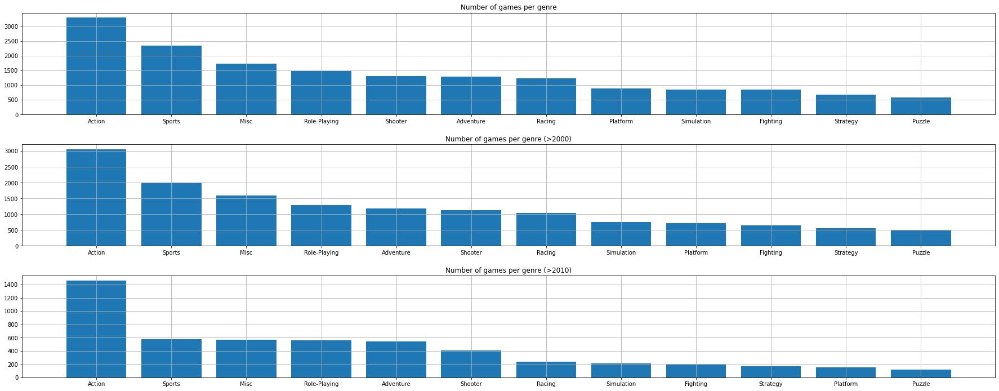

In [30]:
platform = dict(sorted(count_elements(df["Genre"]).items(), key=lambda item: item[1], reverse = True))
platform2000 = dict(sorted(count_elements(df2000["Genre"]).items(), key=lambda item: item[1], reverse = True))
platform2010 = dict(sorted(count_elements(df2010["Genre"]).items(), key=lambda item: item[1], reverse = True))

fig, axs = plt.subplots(3,1,figsize=(25,10))

axs[0].set_title("Number of games per genre")
axs[0].bar(platform.keys(), platform.values())
axs[0].grid(True)

axs[1].set_title("Number of games per genre (>2000)")
axs[1].bar(platform2000.keys(), platform2000.values())
axs[1].grid(True)

axs[2].set_title("Number of games per genre (>2010)")
axs[2].bar(platform2010.keys(), platform2010.values())
axs[2].grid(True)

fig.tight_layout(pad=2.0)

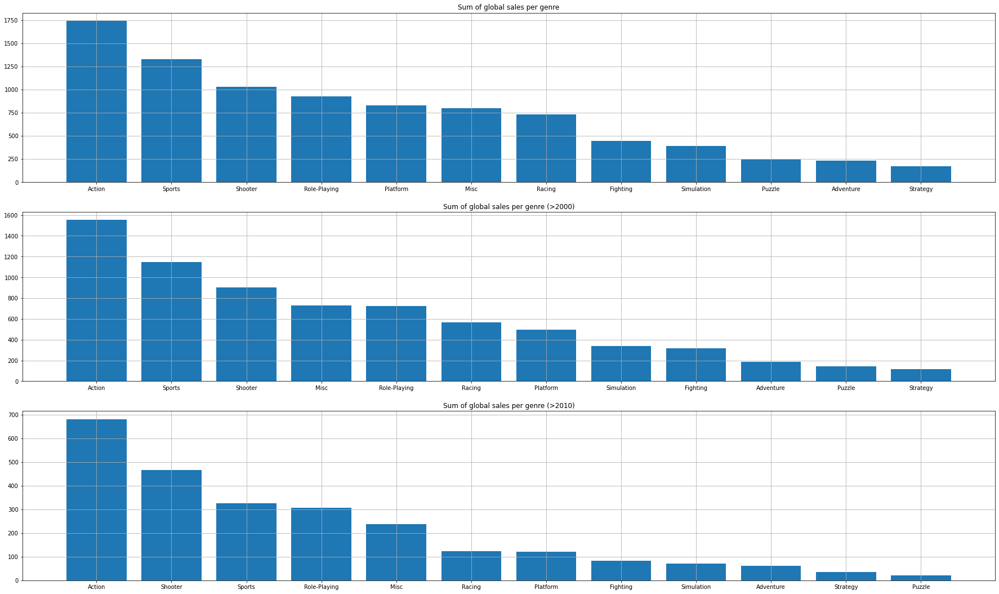

In [31]:
sales = df.groupby('Genre')['Global_Sales'].sum().sort_values(ascending = False)
names = []
values = []
for i in range(len(sales)):
    names.append(sales.keys()[i])
    values.append(sales[i])

sales2000 = df2000.groupby('Genre')['Global_Sales'].sum().sort_values(ascending = False)
names2000 = []
values2000 = []
for i in range(len(sales2000)):
    names2000.append(sales2000.keys()[i])
    values2000.append(sales2000[i])
    
sales2010 = df2010.groupby('Genre')['Global_Sales'].sum().sort_values(ascending = False)
names2010 = []
values2010 = []
for i in range(len(sales2010)):
    names2010.append(sales2010.keys()[i])
    values2010.append(sales2010[i])
    
fig, axs = plt.subplots(3,1,figsize=(25,15))

axs[0].set_title("Sum of global sales per genre")
axs[0].bar(names, values)
axs[0].grid(True)

axs[1].set_title("Sum of global sales per genre (>2000)")
axs[1].bar(names2000, values2000)
axs[1].grid(True)

axs[2].set_title("Sum of global sales per genre (>2010)")
axs[2].bar(names2010, values2010)
axs[2].grid(True)

fig.tight_layout(pad=2.0)

In [32]:
# Nie ma sensu normalizować/standaryzować, ponieważ są na tej samej skali.
Global_Sales_mean = stat.mean(df['Global_Sales'])
Global_Sales_sd = stat.stdev(df['Global_Sales'])
df['Global_Sales_std'] = df.apply(lambda x: (x['Global_Sales']-Global_Sales_mean)/Global_Sales_sd, axis = 1)

Global_Sales_min = min(df['Global_Sales'])
Global_Sales_max = max(df['Global_Sales'])
df['Global_Sales_norm'] = df.apply(lambda x: (x['Global_Sales']-Global_Sales_min)/(Global_Sales_max-Global_Sales_min), axis = 1)

NA_Sales_mean = stat.mean(df['NA_Sales'])
NA_Sales_sd = stat.stdev(df['NA_Sales'])
df['NA_Sales_std'] = df.apply(lambda x: (x['NA_Sales']-NA_Sales_mean)/NA_Sales_sd, axis = 1)

NA_Sales_min = min(df['NA_Sales'])
NA_Sales_max = max(df['NA_Sales'])
df['NA_Sales_norm'] = df.apply(lambda x: (x['NA_Sales']-NA_Sales_min)/(NA_Sales_max-NA_Sales_min), axis = 1)

df.head()

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Platform_Year,Global_Sales_std,Global_Sales_norm,NA_Sales_std,NA_Sales_norm
8293,8295,Shin Megami Tensei IV: Final,3DS,2016.0,Role-Playing,Deep Silver,0.03,0.00,0.14,0.00,0.17,2011.0,-0.236700,0.001934,-0.287115,0.000723
13647,13649,Hitman (2016),PS4,2016.0,Action,Square Enix,0.00,0.04,0.00,0.01,0.04,2013.0,-0.319978,0.000363,-0.323724,0.000000
13596,13598,Card Fight!! Vanguard G: Stride to Victory!!,3DS,2016.0,Misc,FuRyu,0.00,0.00,0.04,0.00,0.04,2011.0,-0.319978,0.000363,-0.323724,0.000000
13602,13604,Refrain no Chika Meikyuu to Majo no Ryodan,PSV,2016.0,Action,Nippon Ichi Software,0.00,0.00,0.04,0.00,0.04,2011.0,-0.319978,0.000363,-0.323724,0.000000
13614,13616,Utawarerumono: Futari no Hakuoro,PS4,2016.0,Misc,Aqua Plus,0.00,0.00,0.04,0.00,0.04,2013.0,-0.319978,0.000363,-0.323724,0.000000


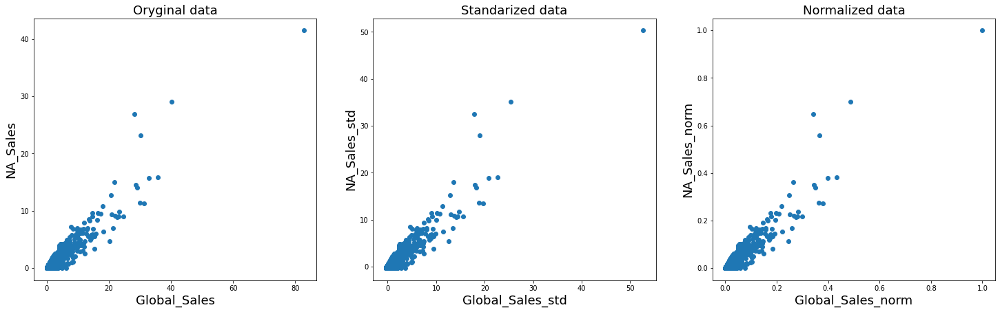

In [33]:
fig, axs = plt.subplots(1,3,figsize=(25,7))
x = df['Global_Sales']
x_std = df['Global_Sales_std']
x_norm = df['Global_Sales_norm']
y = df['NA_Sales']
y_std = df['NA_Sales_std']
y_norm = df['NA_Sales_norm']

axs[0].set_title("Oryginal data", fontsize=18)
axs[0].set_xlabel('Global_Sales', fontsize=18)
axs[0].set_ylabel('NA_Sales', fontsize=18)
axs[0].scatter(x, y)

axs[1].set_title("Standarized data", fontsize=18)
axs[1].set_xlabel('Global_Sales_std', fontsize=18)
axs[1].set_ylabel('NA_Sales_std', fontsize=18)
axs[1].scatter(x_std, y_std)

axs[2].set_title("Normalized data", fontsize=18)
axs[2].set_xlabel('Global_Sales_norm', fontsize=18)
axs[2].set_ylabel('NA_Sales_norm', fontsize=18)
axs[2].scatter(x_norm, y_norm)

In [34]:
df = df.drop(['Global_Sales_std', 'Global_Sales_norm', 'NA_Sales_std', 'NA_Sales_norm'], axis=1)
df.head()

,Rank,Name,Platform,Year,Genre,Publisher,NA_Sales,EU_Sales,JP_Sales,Other_Sales,Global_Sales,Platform_Year
8293,8295,Shin Megami Tensei IV: Final,3DS,2016.0,Role-Playing,Deep Silver,0.03,0.00,0.14,0.00,0.17,2011.0
13647,13649,Hitman (2016),PS4,2016.0,Action,Square Enix,0.00,0.04,0.00,0.01,0.04,2013.0
13596,13598,Card Fight!! Vanguard G: Stride to Victory!!,3DS,2016.0,Misc,FuRyu,0.00,0.00,0.04,0.00,0.04,2011.0
13602,13604,Refrain no Chika Meikyuu to Majo no Ryodan,PSV,2016.0,Action,Nippon Ichi Software,0.00,0.00,0.04,0.00,0.04,2011.0
13614,13616,Utawarerumono: Futari no Hakuoro,PS4,2016.0,Misc,Aqua Plus,0.00,0.00,0.04,0.00,0.04,2013.0


No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


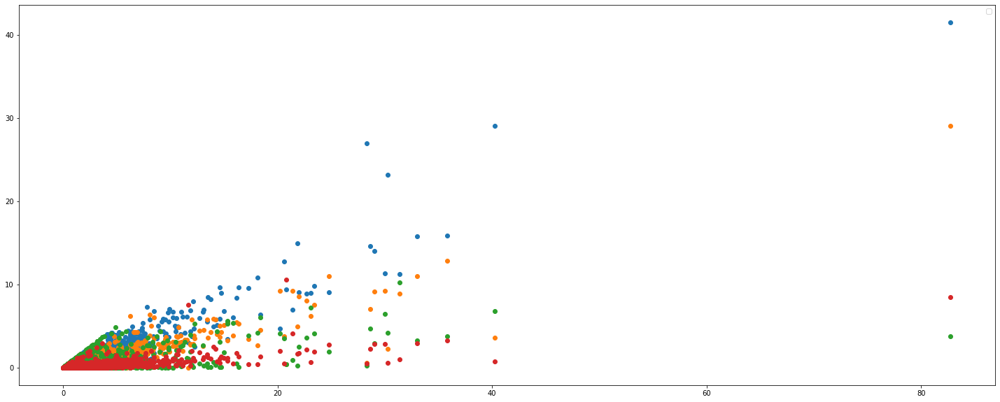

In [35]:
# Podgląd danych
x = df['Global_Sales']
y = df['NA_Sales']
y2 = df['EU_Sales']
y3 = df['JP_Sales']
y4 = df['Other_Sales']

plt.figure(figsize=(25, 10))

plt.scatter(x, y)
plt.scatter(x, y2)
plt.scatter(x, y3)
plt.scatter(x, y4)
plt.legend()

plt.show()

In [36]:
# Agregowanie danych do heatmapki
regions = ['NA', 'JP', 'EU', 'Other']

region_sales_sufix = '_Sales'
regions_agg = {}

for region in regions:
    regions_agg[region + region_sales_sufix] = 'sum'

regions_agg['Global_Sales'] = 'sum'
regions_agg

{'NA_Sales': 'sum',
 'JP_Sales': 'sum',
 'EU_Sales': 'sum',
 'Other_Sales': 'sum',
 'Global_Sales': 'sum'}

In [37]:
df_agg = df.groupby(['Genre']).agg(regions_agg)
df_agg  = df_agg.sort_values('Global_Sales', ascending=False)
df_agg

,NA_Sales,JP_Sales,EU_Sales,Other_Sales,Global_Sales
Genre,,,,,
Action,872.52,158.66,523.41,186.98,1742.58
Sports,681.07,135.10,375.95,134.70,1327.23
Shooter,578.39,38.20,312.77,102.57,1032.44
Role-Playing,326.71,350.84,187.70,59.48,924.83
Platform,445.99,130.65,201.15,51.51,829.63
Misc,404.15,107.69,214.19,74.17,800.84
Racing,357.99,56.65,237.10,76.93,728.92
Fighting,223.00,87.15,101.20,36.65,447.96
Simulation,182.14,63.54,113.23,31.39,390.58


In [38]:
fig = px.imshow(df_agg.drop('Global_Sales', 1).T)
fig.update_layout(title="Sales distribution by genre and region (Millions).")
fig.show()

C:\Users\User\AppData\Local\Temp\ipykernel_10460\1190121248.py:1: FutureWarning: In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.
  fig = px.imshow(df_agg.drop('Global_Sales', 1).T)


In [39]:
df_agg2010 = df2010.groupby(['Genre']).agg(regions_agg)
df_agg2010  = df_agg2010.sort_values('Global_Sales', ascending=False)
df_agg2010

,NA_Sales,JP_Sales,EU_Sales,Other_Sales,Global_Sales
Genre,,,,,
Action,291.50,70.73,239.58,79.36,681.48
Shooter,228.70,13.55,167.58,55.37,465.36
Sports,155.14,15.36,115.92,39.47,325.90
Role-Playing,107.70,100.55,73.82,23.92,306.06
Misc,125.38,24.19,68.10,20.93,238.59
Racing,45.70,6.65,55.57,15.87,123.82
Platform,55.47,15.75,38.69,10.84,120.69
Fighting,38.95,13.76,20.87,8.49,82.08
Simulation,26.88,13.20,25.41,6.02,71.53


In [40]:
fig = px.imshow(df_agg2010.drop('Global_Sales', 1).T)
fig.update_layout(title="Sales distribution by genre and region (Millions) after 2010.")
fig.show()

C:\Users\User\AppData\Local\Temp\ipykernel_10460\3874545336.py:1: FutureWarning:

In a future version of pandas all arguments of DataFrame.drop except for the argument 'labels' will be keyword-only.



# Data clustering

## K-means

In [41]:
def k_means_measures(dataset, a: int, b: int, n_0: int):
    X = dataset.iloc[:,a:b]
    kmeans = KMeans(n_clusters=n_0)
    kmeans.fit(X)
    
    C = kmeans.labels_
    
    return davies_bouldin_score(X, C), silhouette_score(X, C)

def k_means_plot(dataset, a: int, b: int, n_0: int, x: str, y: str, z: str):
    X = dataset.iloc[:,a:b]
    kmeans = KMeans(n_clusters=n_0)
    kmeans.fit(X)
    
    C = kmeans.labels_
    
    print("davies_bouldin_score",davies_bouldin_score(X, C))
    print("silhouette_score",silhouette_score(X, C))
    
    fig = px.scatter_3d(dataset,
           x = dataset[x],
           y = dataset[y],
           z = dataset[z],
           color = C,
           hover_data = dataset.columns)
    
    fig.show()
    
    return C

2


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



3


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



4


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



5


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



6


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



7


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



8


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



9


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



10


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



11


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



12


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



13


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



14


c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



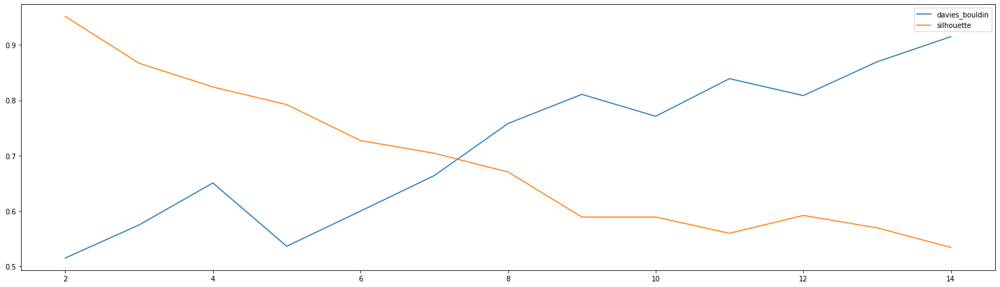

In [42]:
davies_bouldin = []
silhouette = []
x = list(range(2,15))
for i in x:
    print(i)
    davies_bouldin.append(k_means_measures(df, 6, 11, i)[0])
    silhouette.append(k_means_measures(df, 6, 11, i)[1])


plt.figure(figsize=(25, 7))   
plt.plot(x, davies_bouldin, label = "davies_bouldin")
plt.plot(x, silhouette, label = "silhouette")
plt.legend()
plt.show()

In [43]:
k_means_plot(df, 6, 11, 4, 'NA_Sales', 'EU_Sales', 'JP_Sales')

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



davies_bouldin_score 0.6519291481075353
silhouette_score 0.8229432280276725


array([1, 1, 1, ..., 1, 1, 1])

In [44]:
k_means_plot(df, 6, 11, 5, 'NA_Sales', 'EU_Sales', 'JP_Sales')

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



davies_bouldin_score 0.535606553609465
silhouette_score 0.7910639390801241


array([0, 0, 0, ..., 0, 0, 0])

## Affinity Propagation

In [45]:
tst = df

In [46]:
af =  AffinityPropagation(damping=0.5).fit(tst.iloc[:,6:10].values)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_

print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:,6:10].values, labels))
print("silhouette_score",silhouette_score(tst.iloc[:,6:10].values, labels))

fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['JP_Sales'], z = tst['EU_Sales'], color = labels, hover_data = tst.columns)
fig.show()

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning:

Affinity propagation did not converge, this model may return degenerate cluster centers and labels.



davies_bouldin_score 7533.528957321798
silhouette_score 0.05917166346595008


In [47]:
af =  AffinityPropagation(damping=0.75).fit(tst.iloc[:,6:10].values)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_

print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:,6:10].values, labels))
print("silhouette_score",silhouette_score(tst.iloc[:,6:10].values, labels))

fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['JP_Sales'], z = tst['EU_Sales'], color = labels, hover_data = tst.columns)
fig.show()

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning:

Affinity propagation did not converge, this model may return degenerate cluster centers and labels.



davies_bouldin_score 62565.140013873875
silhouette_score 0.10700484398304869


In [48]:
af =  AffinityPropagation(damping=0.90).fit(tst.iloc[:,6:10].values)
cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_

print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:,6:10].values, labels))
print("silhouette_score",silhouette_score(tst.iloc[:,6:10].values, labels))

fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['JP_Sales'], z = tst['EU_Sales'], color = labels, hover_data = tst.columns)
fig.show()

c:\Users\User\Anaconda3\envs\pyCaret_env\lib\site-packages\sklearn\cluster\_affinity_propagation.py:143: ConvergenceWarning:

Affinity propagation did not converge, this model may return degenerate cluster centers and labels.



davies_bouldin_score 13121.014069563613
silhouette_score 0.1709869963133208


## Hierarchy clustering

In [49]:
# The distance metric to use. The distance function can be ‘braycurtis’, ‘canberra’, ‘chebyshev’, ‘cityblock’, ‘correlation’, ‘cosine’, ‘dice’, ‘euclidean’, ‘hamming’, ‘jaccard’,
# ‘jensenshannon’, ‘kulsinski’, ‘kulczynski1’, ‘mahalanobis’, ‘matching’, ‘minkowski’, ‘rogerstanimoto’, ‘russellrao’, ‘seuclidean’, ‘sokalmichener’, ‘sokalsneath’,‘sqeuclidean’, ‘yule’.

def hierarchy_clustering_measures(dataset, a: int, b: int, typ: str, metryka: str, cutoff: float):
    X = dataset.iloc[:,a:b].values
    Z = hier.linkage(X,typ,metryka)

    C = hier.fcluster(Z, t=cutoff, criterion = 'distance')

    return davies_bouldin_score(X, C),silhouette_score(X, C)

def hierarchy_clustering_plot(dataset, a: int, b: int, typ: str, metryka: str, cutoff: float, x: str, y: str, z: str):
    X = dataset.iloc[:,a:b].values
    Z = hier.linkage(X,typ,metryka)

    plt.figure(figsize=(25, 10))
    plt.title('Hierarchical Clustering Dendrogram')
    plt.xlabel('sample index')
    plt.ylabel('distance')
    hier.dendrogram(
        Z,
        leaf_rotation=90., 
        leaf_font_size=25.,  
        truncate_mode='level',
        p=5
    )
    max_d= cutoff
    plt.axhline(y=max_d, c='k')
    plt.show()

    C = hier.fcluster(Z, t=cutoff, criterion = 'distance')

    print(C)
    print("davies_bouldin_score",davies_bouldin_score(X, C))
    print("silhouette_score",silhouette_score(X, C))
    
    fig = px.scatter_3d(dataset, x = dataset[x], y = dataset[y], z = dataset[z], color = C, hover_data = dataset.columns)
    fig.show()
    
    return C

2
3
4
5
6
7
8
9
10
11
12
13
14
15
16
17
18
19
20
21


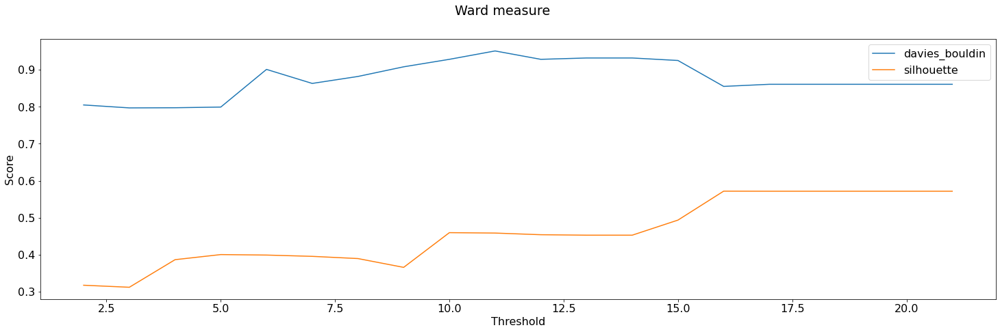

In [50]:
davies_bouldin = []
silhouette = []
x = list(range(2,22))
for i in x:
    print(i)
    davies_bouldin.append(hierarchy_clustering_measures(df, 6, 10, 'ward', 'euclidean', i)[0])
    silhouette.append(hierarchy_clustering_measures(df, 6, 10, 'ward', 'euclidean', i)[1])

fig, ax = plt.subplots(figsize=(25, 7))

# Set general font size
plt.rcParams['font.size'] = '16'

# Set tick font size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(16)

ax.plot(x, davies_bouldin, label = "davies_bouldin")
ax.plot(x, silhouette, label = "silhouette")
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Score', fontsize=16)

fig.suptitle('Ward measure')
ax.legend()

plt.show()

4
5
6
7
8
9


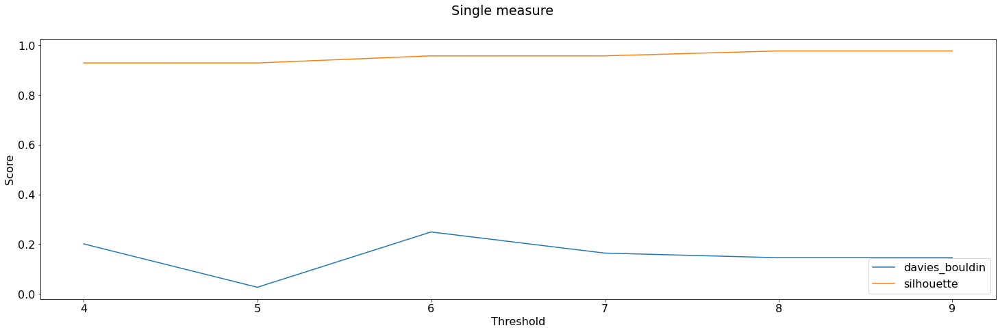

In [51]:
davies_bouldin = []
silhouette = []
x = list(range(4,10))
for i in x:
    print(i)
    davies_bouldin.append(hierarchy_clustering_measures(df, 6, 10, 'single', 'minkowski', i)[0])
    silhouette.append(hierarchy_clustering_measures(df, 6, 10, 'single', 'minkowski', i)[1])

fig, ax = plt.subplots(figsize=(25, 7))

# Set general font size
plt.rcParams['font.size'] = '16'

# Set tick font size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(16)

ax.plot(x, davies_bouldin, label = "davies_bouldin")
ax.plot(x, silhouette, label = "silhouette")
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Score', fontsize=16)

fig.suptitle('Single measure')
ax.legend()

plt.show()

10
11
12
13
14
15
16
17
18
19
20
21
22
23
24
25
26
27
28
29
30
31
32
33
34
35
36
37
38
39
40
41


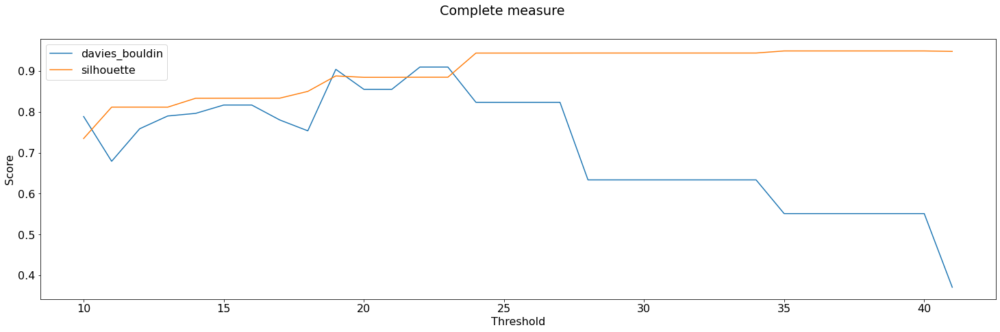

In [52]:
davies_bouldin = []
silhouette = []
x = list(range(10,42))
for i in x:
    print(i)
    davies_bouldin.append(hierarchy_clustering_measures(df, 6, 10, 'complete', 'seuclidean', i)[0])
    silhouette.append(hierarchy_clustering_measures(df, 6, 10, 'complete', 'seuclidean', i)[1])

fig, ax = plt.subplots(figsize=(25, 7))

# Set general font size
plt.rcParams['font.size'] = '16'

# Set tick font size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(16)

ax.plot(x, davies_bouldin, label = "davies_bouldin")
ax.plot(x, silhouette, label = "silhouette")
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Score', fontsize=16)

fig.suptitle('Complete measure')
ax.legend()

plt.show()

0.5
1.0
1.5
2.0
2.5
3.0
3.5
4.0
4.5
5.0
5.5
6.0
6.5
7.0
7.5
8.0
8.5
9.0
9.5
10.0
10.5


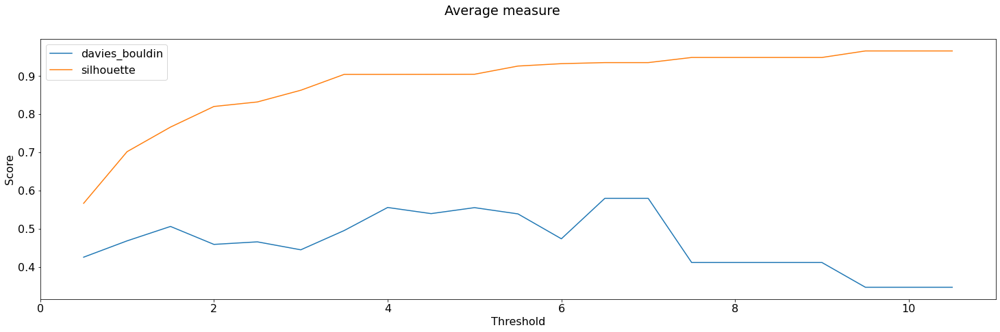

In [53]:
davies_bouldin = []
silhouette = []
x = np.arange(0.5, 11, 0.5)
for i in x:
    print(i)
    davies_bouldin.append(hierarchy_clustering_measures(df, 6, 10, 'average', 'chebyshev', i)[0])
    silhouette.append(hierarchy_clustering_measures(df, 6, 10, 'average', 'chebyshev', i)[1])

fig, ax = plt.subplots(figsize=(25, 7))

# Set general font size
plt.rcParams['font.size'] = '16'

# Set tick font size
for label in (ax.get_xticklabels() + ax.get_yticklabels()):
    label.set_fontsize(16)

ax.plot(x, davies_bouldin, label = "davies_bouldin")
ax.plot(x, silhouette, label = "silhouette")
plt.xlabel('Threshold', fontsize=16)
plt.ylabel('Score', fontsize=16)

fig.suptitle('Average measure')
ax.legend()

plt.show()

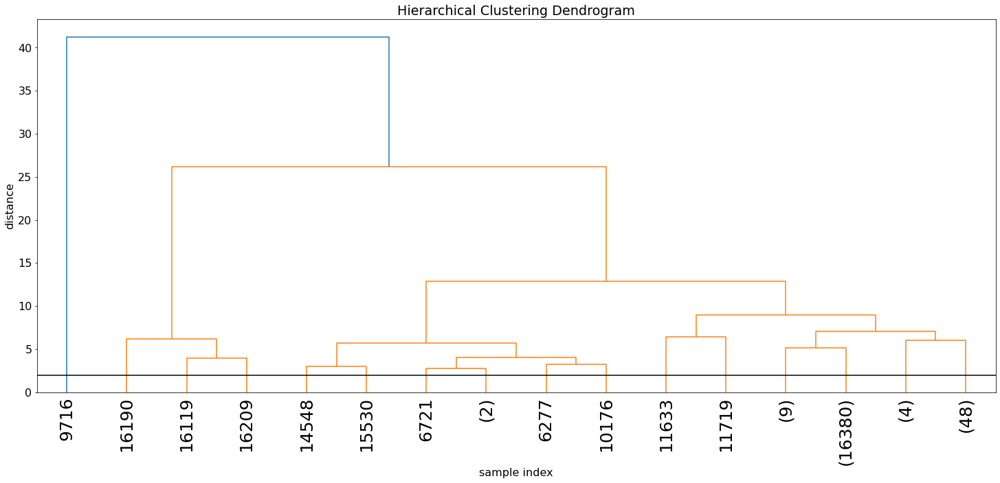

[16 16 16 ... 16 16 16]
davies_bouldin_score 0.45927124110124357
silhouette_score 0.8201226727419814


In [54]:
AVG = hierarchy_clustering_plot(df, 6, 10, 'average', 'chebyshev', 2, 'NA_Sales', 'EU_Sales', 'JP_Sales')
df['average'] = AVG

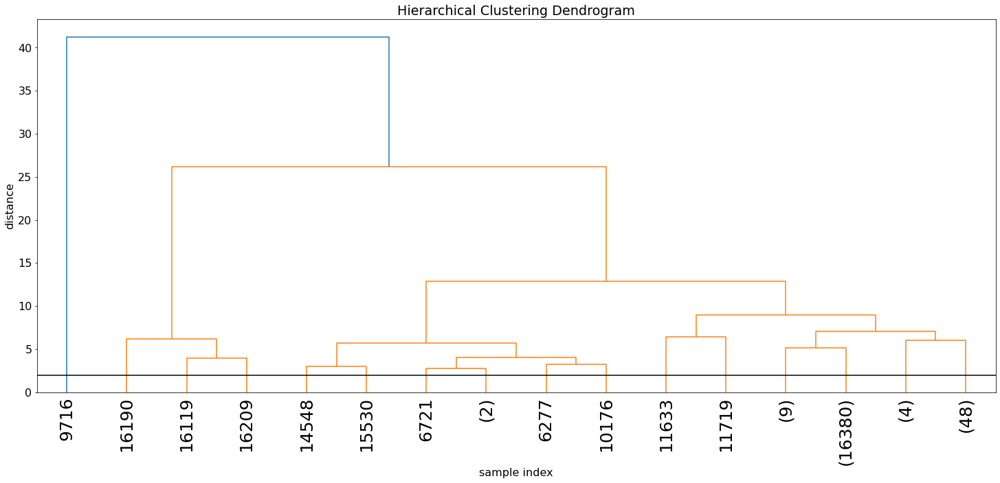

[16 16 16 ... 16 16 16]
davies_bouldin_score 0.45927124110124357
silhouette_score 0.8201226727419814


In [55]:
# The distance metric to use. The distance function can be ‘braycurtis’, ‘canberra’, ‘chebyshev’, ‘cityblock’, ‘correlation’, ‘cosine’, ‘dice’, ‘euclidean’, ‘hamming’, ‘jaccard’,
# ‘jensenshannon’, ‘kulsinski’, ‘mahalanobis’, ‘matching’, ‘minkowski’, ‘rogerstanimoto’, ‘russellrao’, ‘seuclidean’, ‘sokalmichener’, ‘sokalsneath’,‘sqeuclidean’, ‘yule’.

Z = hier.linkage(df.iloc[:,6:10], method='average', metric='chebyshev')
dist = 2

plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
hier.dendrogram(
    Z,
    leaf_rotation=90., 
    leaf_font_size=25.,  
    truncate_mode='level',
    p=5
)
max_d = dist 
plt.axhline(y=max_d, c='k')
plt.show()

C = hier.fcluster(Z, t=dist, criterion = 'distance')

print(C)
print("davies_bouldin_score",davies_bouldin_score(df.iloc[:,6:10], C))
print("silhouette_score",silhouette_score(df.iloc[:,6:10], C))
    
fig = px.scatter_3d(df, x = df['NA_Sales'], y = df['EU_Sales'], z = df['JP_Sales'], color = C, hover_data = df.columns)
fig.show()

## DB_SCAN_clustering with gower distance

In [56]:
def DB_SCAN_clustering(n_0: float, epsilon: float, dataset, distance_matrix, metric: str, x, y, z):
    # Configuring the parameters of the clustering algorithm
        
    dbscan_cluster = DBSCAN(eps=epsilon, 
                            min_samples=n_0, 
                            metric=metric)

    # Fitting the clustering algorithm
    dbscan_cluster.fit(distance_matrix)
    
    C = dbscan_cluster.labels_
    
    print("davies_bouldin_score",davies_bouldin_score(distance_matrix, C))
    print("silhouette_score",silhouette_score(distance_matrix, C))
    
    # Adding the results to a new column in the dataframe
    dataset["cluster"] = C
    print(dataset['cluster'].unique())
    
    
    fig = px.scatter_3d(dataset, x = dataset[x], y = dataset[y] , z = dataset[z], color = dataset['cluster'], hover_data = ['Name','Genre','Publisher','Platform','Year','Global_Sales'])
    fig.show()

In [57]:
df = df.sort_values(['Global_Sales'], ascending = False)
cols = ['NA_Sales','EU_Sales','JP_Sales','Other_Sales','Genre','Year']
distance_matrix = gower.gower_matrix(df[cols], cat_features = [False,False,False,False,True,False])
distance_matrix

array([[0.        , 0.6306776 , 0.45314816, ..., 0.73638076, 0.73648643,
        0.71796787],
       [0.6306776 , 0.        , 0.46900526, ..., 0.56596637, 0.56607205,
        0.54755354],
       [0.45314816, 0.46900526, 0.        , ..., 0.4505516 , 0.45065725,
        0.4321387 ],
       ...,
       [0.73638076, 0.56596637, 0.4505516 , ..., 0.        , 0.16688718,
        0.1854057 ],
       [0.73648643, 0.56607205, 0.45065725, ..., 0.16688718, 0.        ,
        0.1851852 ],
       [0.71796787, 0.54755354, 0.4321387 , ..., 0.1854057 , 0.1851852 ,
        0.        ]], dtype=float32)

In [58]:
# Z uwagi na dane, lepiej zrobic wiecej pozycji w dalszej odleglosci niz mniej pozycji w mniejszej odleglosci (epsilon)
# Higher min_samples or lower eps indicate higher density necessary to form a cluster.
# The larger the data set, the larger the value of MinPts should be
# If the data set is noisier, choose a larger value of MinPts
# Generally, MinPts should be greater than or equal to the dimensionality of the data set
# For 2-dimensional data, use DBSCAN’s default value of MinPts = 4 (Ester et al., 1996).
# If your data has more than 2 dimensions, choose MinPts = 2*dim, where dim= the dimensions of your data set (Sander et al., 1998).
n_0, epsilon = 325, 0.03
DB_SCAN_clustering(n_0, epsilon, df, distance_matrix, "precomputed", 'Global_Sales', 'Year', 'Genre')

davies_bouldin_score 0.8901237592328616
silhouette_score 0.64120466
[-1  1  4  0  7  2  3  6  8  5  9 10 11]


In [59]:
tst = df[df['cluster'] == 0]

# print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:, 6:10], tst['average']))
# print("silhouette_score",silhouette_score(tst.iloc[:, 6:10], tst['average']))

fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['JP_Sales'], z = tst['EU_Sales'], color = tst['average'], hover_data = tst.columns)
fig.show()

In [60]:
tst = df[df['cluster'] == 0]

# print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:, 6:10], tst['average']))
# print("silhouette_score",silhouette_score(tst.iloc[:, 6:10], tst['average']))

fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['JP_Sales'], z = tst['EU_Sales'], color = tst['average'], hover_data = tst.columns)
fig.show()

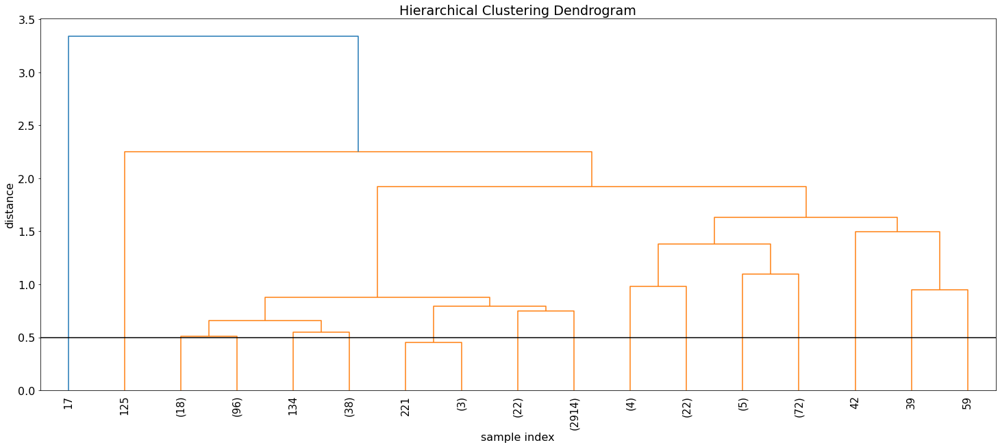

[12 13 11 ...  9  9  9]
davies_bouldin_score 0.5660195145342718
silhouette_score 0.5654361136489043


In [61]:
Z = hier.linkage(tst.iloc[:,6:10],'average','chebyshev')
dist = 0.5

plt.figure(figsize=(25, 10))
plt.title('Hierarchical Clustering Dendrogram')
plt.xlabel('sample index')
plt.ylabel('distance')
hier.dendrogram(
    Z,
    leaf_rotation=90., 
    leaf_font_size=15.,  
    truncate_mode='level',
    p=5
)
max_d = dist 
plt.axhline(y=max_d, c='k')
plt.show()

C = hier.fcluster(Z, t=dist, criterion = 'distance')

print(C)
print("davies_bouldin_score",davies_bouldin_score(tst.iloc[:,6:10], C))
print("silhouette_score",silhouette_score(tst.iloc[:,6:10], C))
    
fig = px.scatter_3d(tst, x = tst['NA_Sales'], y = tst['EU_Sales'], z = tst['JP_Sales'], color = C, hover_data = tst.columns)
fig.show()